Treat image ROI takes electron diffraction patterns and calibrate the image, rotate it, draw the BZ around the Bragg peak and average equivalent BZ together

In [1]:
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import gridspec
from matplotlib.patches import Polygon
from matplotlib.patches import Circle
from mpl_toolkits.axes_grid1 import make_axes_locatable
import imutils
import glob
import cv2  # importing cv
import find_peak
import scipy.special as special
from matplotlib import ticker
from scipy.fft import fft, fftfreq
from scipy.optimize import curve_fit
import nfft
import scipy
import scipy.fft
import functions_analysis as fa
from skimage import img_as_float
from skimage import filters
%matplotlib inline 

path = r'C:\Path\To\Data'
path = r'C:\Users\rclaude\Documents\projet\graphite\data_UED'
path_main=path+r'\PROCESSED'
scans = [ '1.55 eV',  '3.1 eV' ]
scan_number = [ '800nm',  '400nm' ]

data = {}

for k, scan_name in enumerate(scans):
    data[scan_name] = {}
    data[scan_name] = {}
    df= pd.read_pickle(path_main + r'\PROC_'+ scan_number[k], 
                       compression={'method': 'gzip', 'compresslevel': 1, 'mtime': 1})

    data[scan_name]['imgOFF'] = np.stack(df['imgOFF'])
    data[scan_name]['imgON'] = np.stack(df['imgON'])
    data[scan_name]['delay'] = np.stack(df['delay'])
    data[scan_name]['t0_index'] = df.attrs['t0_index']
    data[scan_name]['Zorder'] = df.attrs['Zorder_pos']
    data[scan_name]['cal'] = df.attrs['calibration']

    data[scan_name]['kx'] = data[scan_name]['cal'] *(np.arange(np.size(data[scan_name]['imgON'][0],1)) -
                                                      data[scan_name]['Zorder'] [1])
    data[scan_name]['ky'] = data[scan_name]['cal'] *(np.arange(np.size(data[scan_name]['imgON'][0],0)) - 
                                                     data[scan_name]['Zorder'] [0])

In [2]:
L = df.attrs['peak_dist']
Zorder = df.attrs['Zorder_pos']
cal = df.attrs['calibration']
t0 = df.attrs['t0_index']

cc =  L * np.sqrt(3)/3 *np.exp(1j * np.pi  * ( 1./3 * np.arange(7))) ## for hexagonal BZ


#### construction position of the Bragg peak, ordered by family
BP_BZ = []
for i in range(6):
    BP_BZ.append([L*np.cos(np.pi*i/3), L*np.sin(np.pi*i/3)])
BP_pos = [Zorder + np.array(BP_BZ)]
BP_BZ = []
for i in range(6):
    BP_BZ.append([2*L*np.cos(np.pi*i/3), 2*L*np.sin(np.pi*i/3)])
BP_pos.append(Zorder + np.array(BP_BZ))
BP_BZ = []
for i in range(6):
    BP_BZ.append([np.sqrt(3)*L*np.cos(np.pi*i/3+np.pi/6), np.sqrt(3)*L*np.sin(np.pi*i/3+np.pi/6)])
BP_pos.append(Zorder + np.array(BP_BZ))
BP_name = ['{100}', '{200}', '{110}']
BP_BZ = []


[array([[336.43523823, 246.97141658],
       [288.95009168, 329.21810301],
       [193.97979858, 329.21810301],
       [146.49465203, 246.97141658],
       [193.97979858, 164.72473015],
       [288.95009168, 164.72473015]]), array([[431.40553133, 246.97141658],
       [336.43523823, 411.46478944],
       [146.49465203, 411.46478944],
       [ 51.52435893, 246.97141658],
       [146.49465203,  82.47804372],
       [336.43523823,  82.47804372]]), array([[383.92038478, 329.21810301],
       [241.46494513, 411.46478944],
       [ 99.00950548, 329.21810301],
       [ 99.00950548, 164.72473015],
       [241.46494513,  82.47804372],
       [383.92038478, 164.72473015]])]


In [3]:
plt.rcParams.update({'font.size': 20})
plt.rc('axes', linewidth=2)
plt.rcParams['xtick.major.size'] = 6
plt.rcParams['xtick.major.width'] = 2
plt.rcParams['xtick.minor.size'] = 3
plt.rcParams['xtick.minor.width'] = 1
plt.rcParams['ytick.major.size'] = 6
plt.rcParams['ytick.major.width'] = 2
plt.rcParams['ytick.minor.size'] = 3
plt.rcParams['ytick.minor.width'] = 1
plt.rc('axes', linewidth=2)
plt.rc('font', family='arial',size=26)
plt.rc('text', usetex=False)

In [4]:
s = 1.2
for scan_name in scans:
    data[scan_name]['imgON'] = filters.gaussian(img_as_float(data[scan_name]['imgON']), sigma=s)
    data[scan_name]['imgOFF'] = filters.gaussian(img_as_float(data[scan_name]['imgOFF']), sigma=s)

<>:29: SyntaxWarning: invalid escape sequence '\D'
<>:29: SyntaxWarning: invalid escape sequence '\D'
C:\Users\rclaude\AppData\Local\Temp\ipykernel_20932\3912427624.py:29: SyntaxWarning: invalid escape sequence '\D'
  plt.suptitle('$\Delta t = %.1f$ ps'%data['1.55 eV']['delay'][k])


delay before time zero :  [-2.39976 -1.73316 -1.39986 -1.06656 -0.79992 -0.53328 -0.26664]
[[[nan nan nan ... nan nan nan]
  [nan nan nan ... nan nan nan]
  [nan nan nan ... nan nan nan]
  ...
  [nan nan nan ... nan nan nan]
  [nan nan nan ... nan nan nan]
  [nan nan nan ... nan nan nan]]

 [[nan nan nan ... nan nan nan]
  [nan nan nan ... nan nan nan]
  [nan nan nan ... nan nan nan]
  ...
  [nan nan nan ... nan nan nan]
  [nan nan nan ... nan nan nan]
  [nan nan nan ... nan nan nan]]

 [[nan nan nan ... nan nan nan]
  [nan nan nan ... nan nan nan]
  [nan nan nan ... nan nan nan]
  ...
  [nan nan nan ... nan nan nan]
  [nan nan nan ... nan nan nan]
  [nan nan nan ... nan nan nan]]

 ...

 [[nan nan nan ... nan nan nan]
  [nan nan nan ... nan nan nan]
  [nan nan nan ... nan nan nan]
  ...
  [nan nan nan ... nan nan nan]
  [nan nan nan ... nan nan nan]
  [nan nan nan ... nan nan nan]]

 [[nan nan nan ... nan nan nan]
  [nan nan nan ... nan nan nan]
  [nan nan nan ... nan nan nan]
  ...
 

C:\Users\rclaude\AppData\Local\Temp\ipykernel_20932\3912427624.py:26: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize = (16, 8))


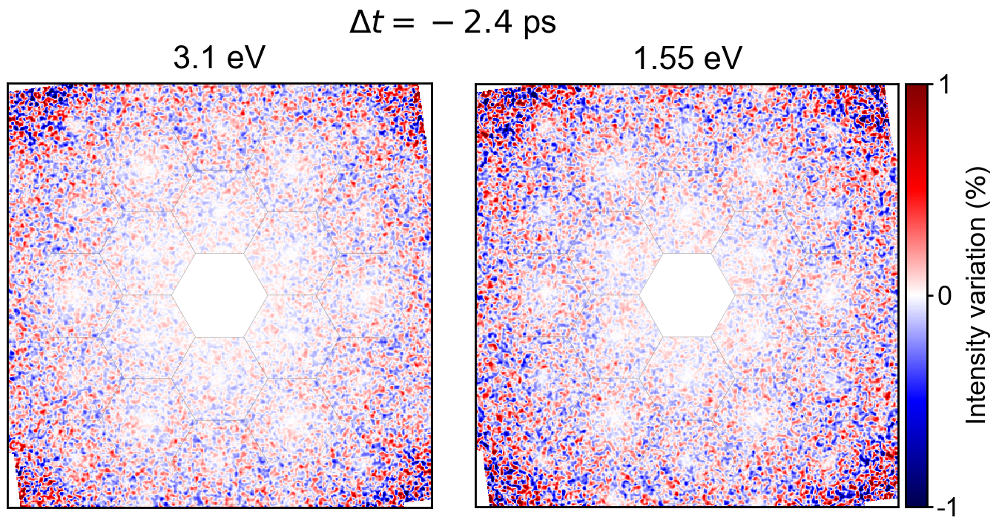

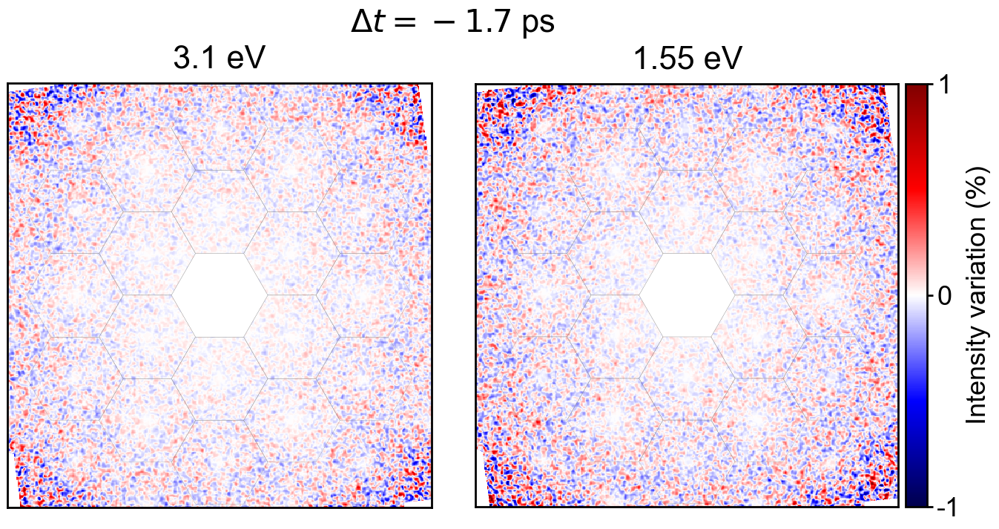

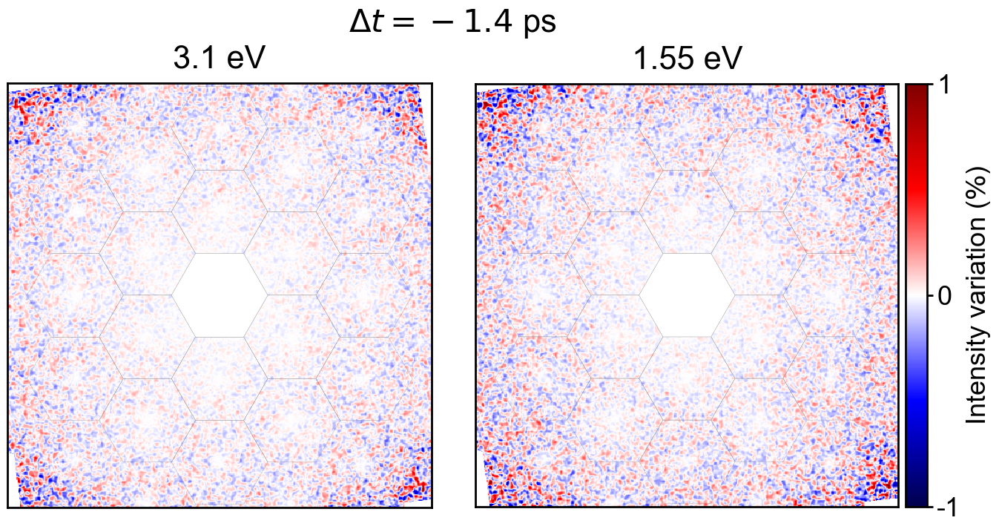

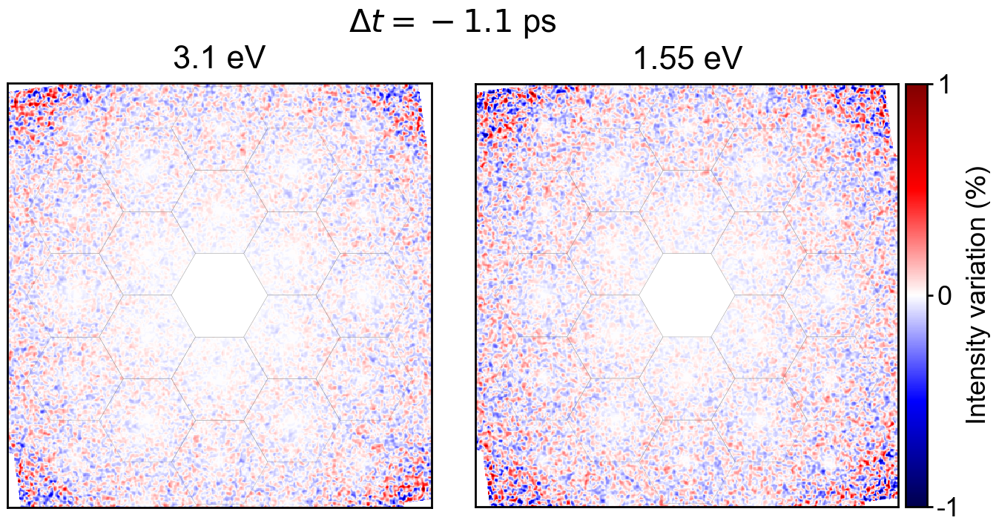

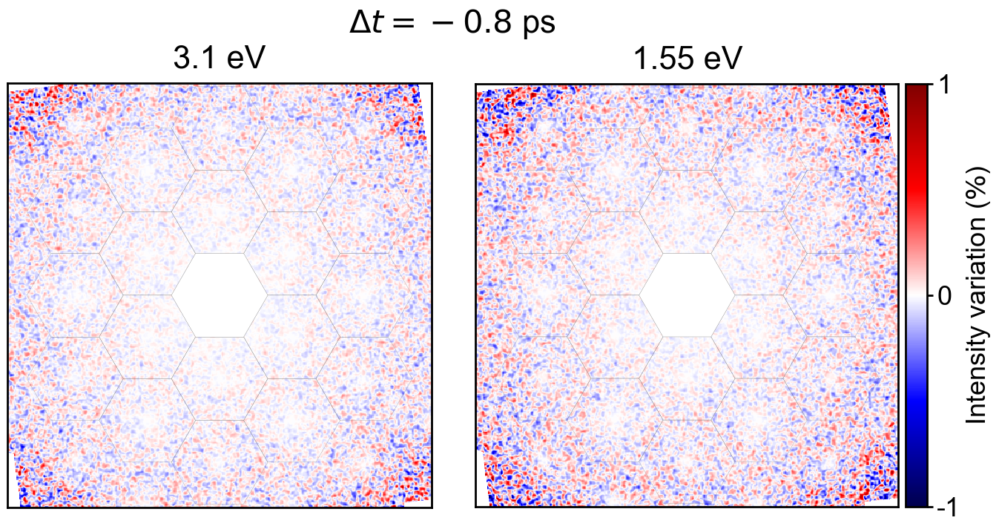

...

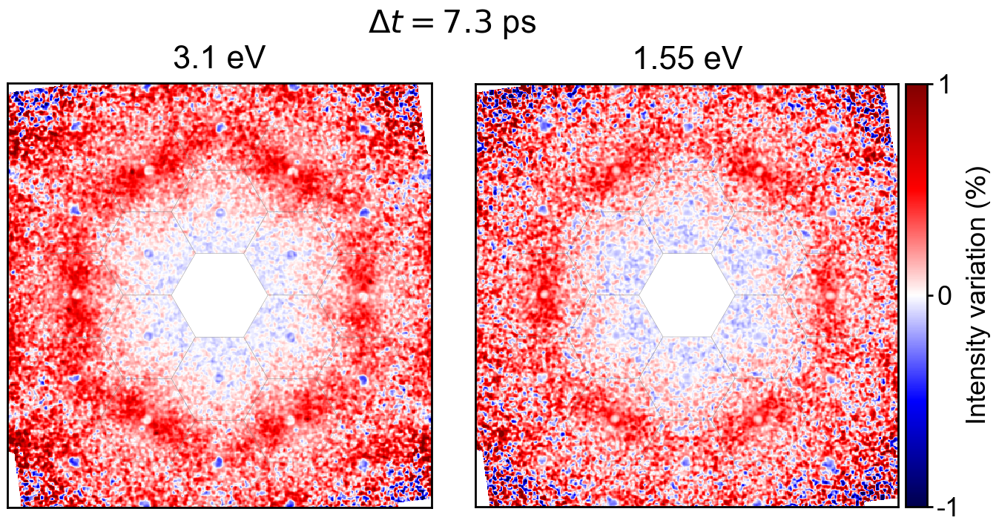

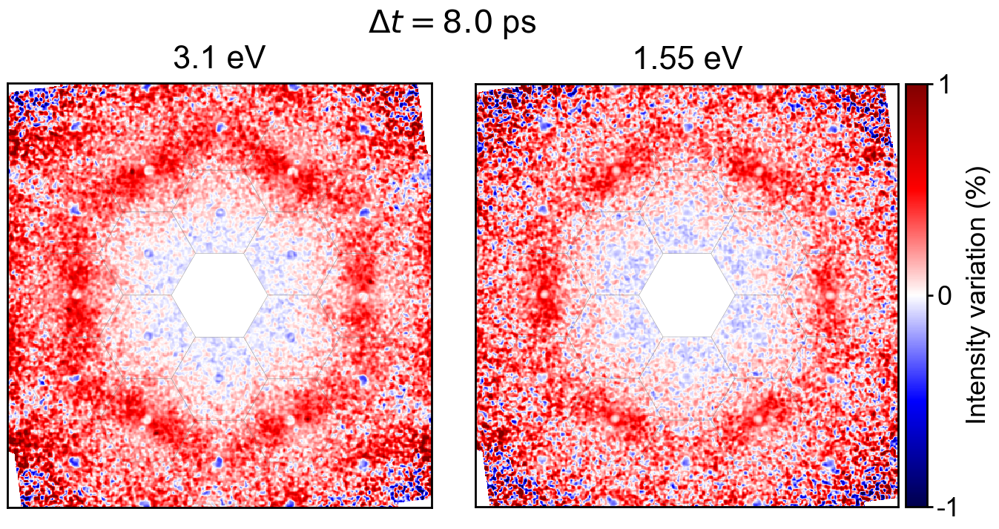

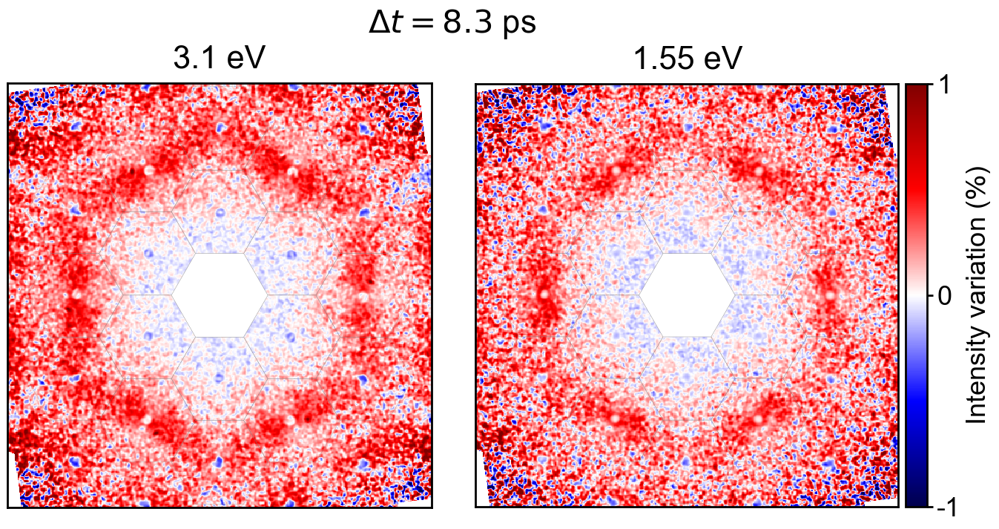

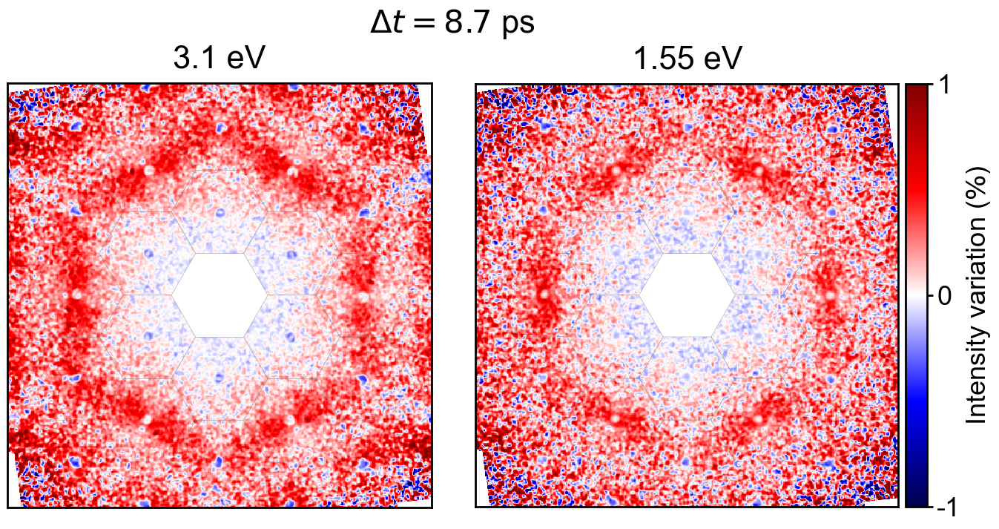

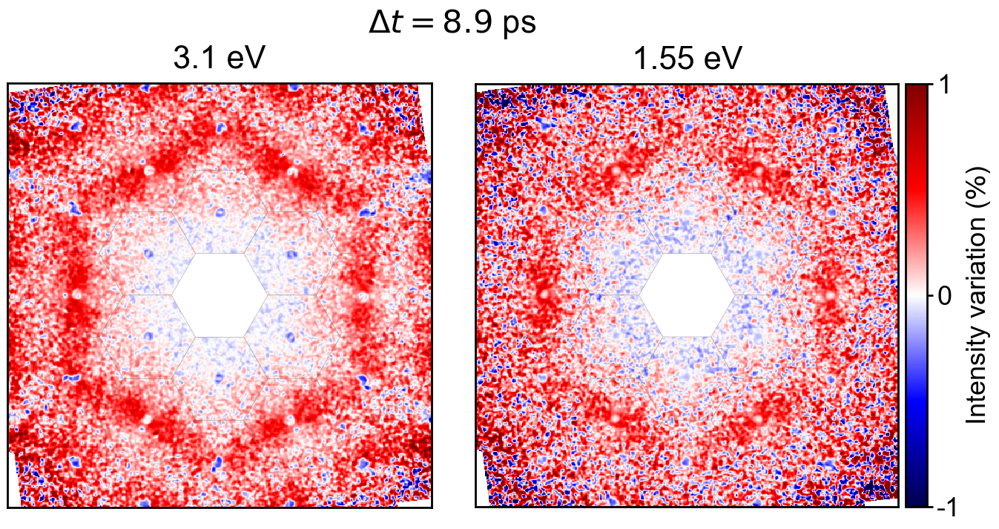

In [5]:
### creation of the images for the video ###
# User needs to create folder named 'DS' in the working folder 

lim=7.5
scan_name = '3.1 eV'
aftert0 = ( data[scan_name]['delay']>0 ) & ( data[scan_name]['delay']<2)
beforet0 =  (data[scan_name]['delay'] < -0.2)
norm_400 = (np.mean(data[scan_name]['imgON'][beforet0], axis=0))/np.mean(data[scan_name]['imgOFF'][beforet0], axis=0)

scan_name = '1.55 eV'
aftert0 = ( data[scan_name]['delay']>0 ) & ( data[scan_name]['delay']<2)
beforet0 =  (data[scan_name]['delay'] < -0.2)
norm_800 = (np.mean(data[scan_name]['imgON'][beforet0], axis=0))/np.mean(data[scan_name]['imgOFF'][beforet0], axis=0)

print('delay before time zero : ', data[scan_name]['delay'][beforet0])
sens = 0.01

print(data['3.1 eV']['imgON'])

for k in range(len(data[scan_name]['delay'])):
    diff_400 = (data['3.1 eV']['imgON'][k])/data['3.1 eV']['imgOFF'][k] - norm_400

    diff_800 = (data['1.55 eV']['imgON'][k])/data['1.55 eV']['imgOFF'][k] - norm_800


    plt.figure(figsize = (16, 8))
    gs = gridspec.GridSpec(1,2, width_ratios=(0.94,1), wspace = 0.1, hspace = 0.1)

    plt.suptitle('$\Delta t = %.1f$ ps'%data['1.55 eV']['delay'][k])
    ax = plt.subplot(gs[0])
    ax.pcolorfast(data[scan_name]['kx'], data[scan_name]['ky'], diff_400, vmin=-sens, vmax = sens, cmap = 'seismic')
    plt.gca().set_aspect('equal')
    plt.title(r'3.1 eV', pad = 15)
    plt.xlim([-lim, lim]), plt.ylim([-lim, lim])
    plt.xticks([]), plt.yticks([])

    for i in range(len(BP_pos)):
        for j in range(len(BP_pos[i])):
            ax.add_patch(Polygon(cal*np.c_[(cc.real+Zorder[1]-BP_pos[i][j][1]), (cc.imag+Zorder[0]-BP_pos[i][j][0])],
                lw=0.2, edgecolor='grey', clip_on=False, facecolor='none'))
    ax.add_patch(Polygon(cal*np.c_[(cc.real), (cc.imag)],lw=0.2, edgecolor='grey', clip_on=True, facecolor='white'))



    ax = plt.subplot(gs[1])
    c = ax.pcolorfast(data[scan_name]['kx'], data[scan_name]['ky'], diff_800, vmin=-sens, vmax = sens, cmap = 'seismic')
    plt.gca().set_aspect('equal')
    plt.title(r'1.55 eV', pad = 15)

    plt.xlim([-lim, lim]), plt.ylim([-lim, lim])
    plt.xticks([]), plt.yticks([])
    # Add colorbar for the right image without resizing it
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.1)  # Create a new axis for the colorbar
    cbar = plt.colorbar(c, cax=cax)
    cbar.set_label(r'Intensity variation ($\%$)')
    ticks = [-sens, 0,  sens]  # Define tick positions
    cbar.set_ticks(ticks)  # Set tick positions
    cbar.set_ticklabels([f"{t:.0f}" for t in 1e2*np.array(ticks)])

    for i in range(len(BP_pos)):
        for j in range(len(BP_pos[i])):
            ax.add_patch(Polygon(cal*np.c_[(cc.real+Zorder[1]-BP_pos[i][j][1]), (cc.imag+Zorder[0]-BP_pos[i][j][0])],
                lw=0.2, edgecolor='grey', clip_on=False, facecolor='none'))
    ax.add_patch(Polygon(cal*np.c_[(cc.real), (cc.imag)],lw=0.2, edgecolor='grey', clip_on=True, facecolor='white'))

    plt.savefig(r'.\DS\delay%02d.png'%k, format='png')
        

In [6]:
### for gif format ###

from PIL import Image
import os

def create_gif_from_pngs(folder_path, output_path, duration=400):
    # Get all PNG files in the folder
    png_files = [f for f in os.listdir(folder_path) if f.endswith('.png')]
    png_files.sort()  # Sort the files if necessary

    # Load images into a list
    images = [Image.open(os.path.join(folder_path, file)) for file in png_files]

    # Save as GIF
    images[0].save(output_path,
                   save_all=True,
                   append_images=images[1:],
                   duration=duration,
                   loop=0)

folder_path = r'.\DS'
output_path = r'.\gif_ds.gif'
create_gif_from_pngs(folder_path, output_path)

In [7]:
### for avi format ### 

import cv2
import os


image_folder = r'.\DS'
video_name = r'.\video_ds.avi'

images = [img for img in sorted(os.listdir(image_folder)) if img.endswith(".png") and img[0] != '.']

frame = cv2.imread(os.path.join(image_folder, images[0]))
height, width, layers = frame.shape

#frame per second 
fps = 3
video = cv2.VideoWriter(video_name, 0, fps, (width,height))

for image in images:
    video.write(cv2.imread(os.path.join(image_folder, image)))
    
cv2.destroyAllWindows()
video.release()